# Kaggle Credit Card Fraud Detection Dataset
The datasets contains transactions made by credit cards in September 2013 by european cardholders. This dataset presents transactions that occurred in two days, where we have 492 frauds out of 284,807 transactions.

Features V1, V2, ... V28 are the principal components obtained with PCA, the only features which have not been transformed with PCA are 'Time' and 'Amount'. The feature 'Time' contains the seconds elapsed between each transaction and the first transaction in the dataset. The feature 'Amount' is the transaction Amount, this feature can be used for example-dependant cost-senstive learning. The Feature 'Class' is the class label, where 1 is a fraudlent transaction and 0 is a normal transcation.
Source: https://www.kaggle.com/dalpozz/creditcardfraud

Here are the methods I will apply to this problem:
- Shallow machine learning classifier: Linear Support Vector Machine (SVM)
- Anomaly detection algorithm: One Class SVM    
- Neural network: autoencoder

**Libraries Used**: pandas, numpy, scikit-learn, keras, matplotlib, plotly, and seaborn


## Precision & Recall Primer

Given the severe class imbalance (0.17% of fraudulent transactions), rather than measuring accuracy I will use precision and recall to evaluate the performance of each method. I will also plot the normalized confusion matrix to help visualize performance of each method.

Precision measures the classifier's ability not to label a negative sample as positive: 

*Precision* = $\frac{TP}{TP+FP}$ 

Recall measures the classifier's ability to find all the positive samples of a class, in other words the true positive rate:

*Recall* = $\frac{TP}{TP+FN}$

where *TP* is true positive, *FN* false negative, and *FP* false positive.

For fraud detection, I want a model with high recall, i.e. a model that captures all fraud transactions. Also, I want a model with minimal false positive rate, which would most likely depend on the goals of the business. High precision is not that important for this particular exercise, so long as the false positive (or false alarm) rate is kept low, for instance less than 5%. Again this would depend on the business goals/application. 


## TL;DR Summary

The goal of this exercise was to detect fraud transactions in a public dataset. I compared the performance (recall score) of three machine learning methods: linear SVM, one class SVM, and an autoencoder. The autoencoder model achieved the highest recall score, suggesting that an autoencoder neural network model could be useful and novel approach to fraud (and perhaps anomaly) direction. 

## 0. Import libraries

In [77]:
import pandas as pd
import numpy as np
import os
import scipy
from time import time

#IPython, matplotlib, & seaborn
import matplotlib.pyplot as plt
%matplotlib inline
from IPython.display import display
import seaborn as sns
sns.set_context("poster", font_scale=1.5, rc={"lines.linewidth": 1.5})

#scikit learn
from sklearn.metrics import precision_recall_curve,average_precision_score,confusion_matrix,classification_report
from sklearn.metrics import precision_score, recall_score
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split,RandomizedSearchCV,GridSearchCV, cross_validate
from sklearn.ensemble import IsolationForest
from sklearn.svm import OneClassSVM, LinearSVC
from sklearn.linear_model import LogisticRegression
from sklearn.dummy import DummyClassifier

#plotly
import plotly.plotly as py
from plotly.graph_objs import Histogram, Figure, Layout
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot
import plotly.figure_factory as ff
init_notebook_mode(connected=True)

#keras
from keras.callbacks import EarlyStopping, ModelCheckpoint
from keras import backend as K
from keras.layers import Input, Dense
from keras.models import Model, load_model

RANDOM_SEED = 42


In [26]:
K.image_data_format()
K.set_image_data_format('channels_first')

In [27]:
#set data path and load .csv file
PATH = "./datasets/credit_fraud" 
os.path.join(PATH,'creditcard.csv')

df_raw = pd.read_csv(os.path.join(PATH,'creditcard.csv'),low_memory=False,)

In [28]:
#visualize a subset of the data from the end
display(df_raw.tail().transpose())

,284802,284803,284804,284805,284806
Time,172786.000000,172787.000000,172788.000000,172788.000000,172792.000000
V1,-11.881118,-0.732789,1.919565,-0.240440,-0.533413
V2,10.071785,-0.055080,-0.301254,0.530483,-0.189733
V3,-9.834783,2.035030,-3.249640,0.702510,0.703337
V4,-2.066656,-0.738589,-0.557828,0.689799,-0.506271
V5,-5.364473,0.868229,2.630515,-0.377961,-0.012546
V6,-2.606837,1.058415,3.031260,0.623708,-0.649617
V7,-4.918215,0.024330,-0.296827,-0.686180,1.577006
V8,7.305334,0.294869,0.708417,0.679145,-0.414650
V9,1.914428,0.584800,0.432454,0.392087,0.486180


As we can see from above, we have 28 features labeled V1-V28 which correspond the principal components. We also have th dollar amount of the transaction and the class label (1-Fraud and 0-Normal)

In [29]:
#get the labels
fraud_labels = df_raw['Class']

#sanity check for missing values
print(fraud_labels.isna().values.any())
print(fraud_labels.isnull().values.any())

False
False


In [30]:
#sanity check for missing values
print(df_raw.isna().values.any())
print(df_raw.isnull().values.any())

False
False


## 1. Data Visualization Plots 

### 1a.  Class distribution
Let's take a look at the classes to see how imbalanced they are

([<matplotlib.axis.XTick at 0x10a203e10>,
 <a list of 2 Text xticklabel objects>)

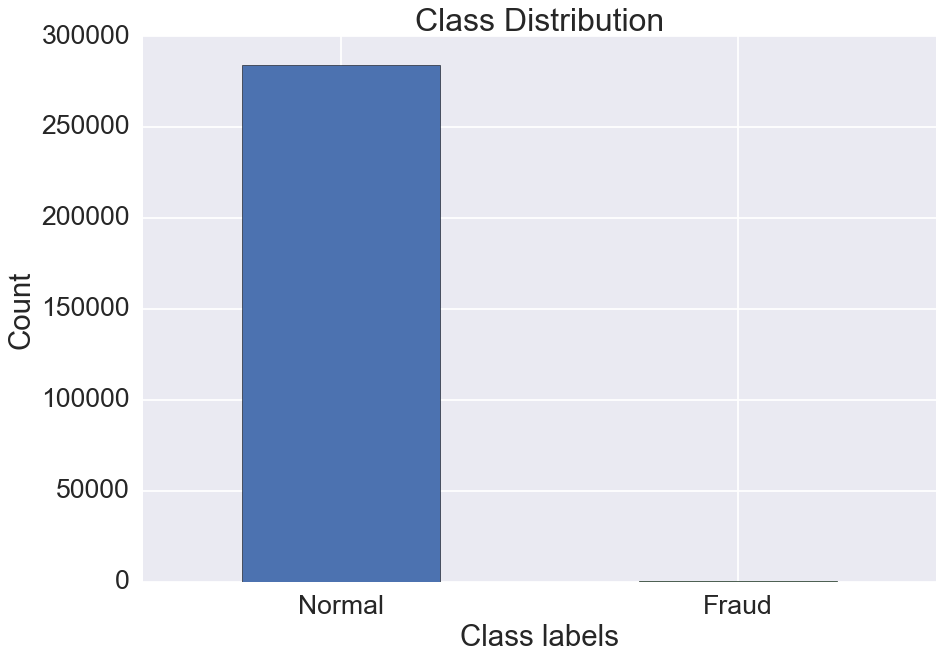

In [31]:
num_class_type = pd.value_counts(fraud_labels,sort=True)
num_class_type.plot(kind='bar',rot=0)
plt.title('Class Distribution')
plt.xlabel('Class labels')
plt.ylabel('Count')
plt.xticks(np.arange(2),['Normal', 'Fraud'])

In [32]:
normal = df_raw[df_raw.Class == 0]
fraud = df_raw[df_raw.Class == 1]

In [33]:
print(normal.shape)
print(fraud.shape)

(284315, 31)
(492, 31)


Report the summary stats of the amounts between the two classes. Notice the mean and variance is higher for for fraud than normal transactions. Hence the amount could be a useful feature. 

In [34]:
print('Normal')
print(normal.Amount.describe())
print('')

print(' Fraud')
print(fraud.Amount.describe())

Normal
count    284315.000000
mean         88.291022
std         250.105092
min           0.000000
25%           5.650000
50%          22.000000
75%          77.050000
max       25691.160000
Name: Amount, dtype: float64

 Fraud
count     492.000000
mean      122.211321
std       256.683288
min         0.000000
25%         1.000000
50%         9.250000
75%       105.890000
max      2125.870000
Name: Amount, dtype: float64


### 1b. Compare transaction amounts
Let's compare the transaction amounts between fraudulent and normal transactions. I'll use a histgram to visualize the comparision. Since there are vastly more normal than fraudulent transactions, I will plot the cumulative probability for each class, so that both classes can be plotted and easily compared on the same graph. 


In [35]:
colors = ['rgb(0, 0, 100)', 'rgb(0, 200, 200)']


In [36]:
trace1 = Histogram(x=fraud.Amount,histnorm='probability',opacity=0.8,cumulative=dict(enabled=True),name='Fraud',
                  marker=dict(color=colors[1]))
trace2 = Histogram(x=normal.Amount,histnorm='probability',opacity=0.8,cumulative=dict(enabled=True),name='Normal',
                  marker=dict(color=colors[0]))
hist_data = [trace2,trace1]
layout = Layout(barmode='overlay',yaxis=dict(title='Cumulative Probability'),
                xaxis=dict(title='Transaction Amount ($)'),
                title='Cumulative Histogram of Transaction Amounts')
fig = Figure(data=hist_data, layout=layout)
iplot(fig,filename='normalized amount transactions')

From the above plot we can see that:
- most transactions (i.e. > 98%) are $1200 or less

- almost all fraudulent transactions occur within this range 

- high dollar amounts (e.g. > $3k) are less likely to be fraudulent transactions (in this dataset) 

For our analysis, we'll keep the $ Amount transactions as features. 

### 1c. When are fraudulent transactions most likely to occur?

In [37]:
#convert to hours
fraud_time = ((fraud.Time)/60./60.) % 24 
normal_time = ((normal.Time)/60./60.) %24 

(0, 24)

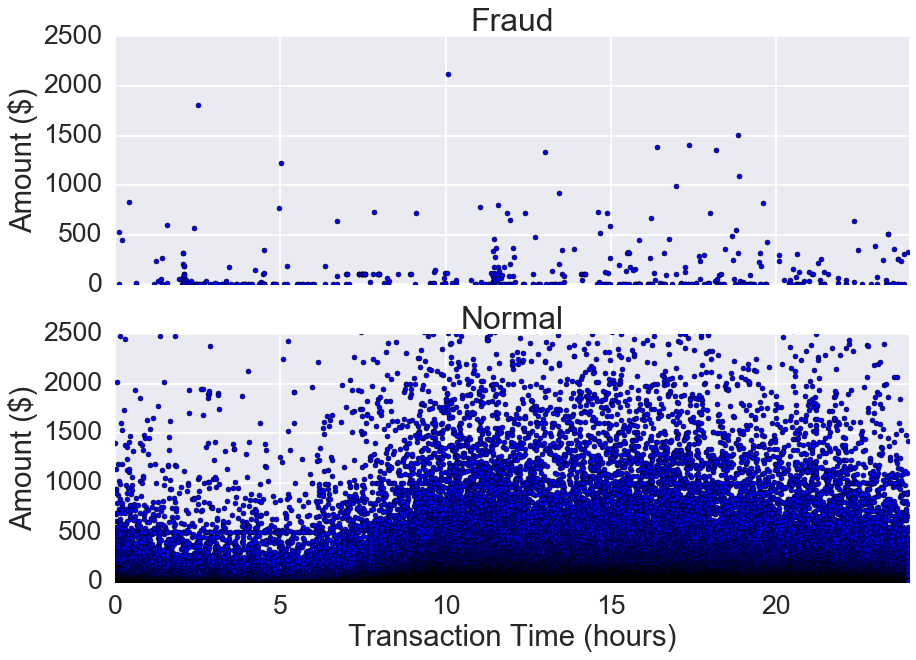

In [38]:
#scatter plot of hourly transaction times for fraud and normal transactions
f, (ax1,ax2) = plt.subplots(2,1,sharex=True,sharey=True)

ax1.scatter(fraud_time, fraud.Amount)
ax1.set_title('Fraud')
ax1.set_ylabel('Amount ($)')

ax2.scatter(normal_time, normal.Amount)
ax2.set_title('Normal')
ax2.set_ylabel('Amount ($)')

plt.xlabel('Transaction Time (hours)')
plt.ylim((-0.1,2500))
plt.xlim((0,24))

From the above scatter plots we observe two peak transaction periods, which most likely correspond to the waking moments for each of the two days. A similar, although sparser pattern is present in the fraud transactions. 

In [39]:
hist_data = [normal_time,fraud_time]
group_labels = ['Normal','Fraud']

fig = ff.create_distplot(hist_data,group_labels,bin_size=2,show_curve=False,show_rug=False,colors=colors)
layout_dict = dict(xaxis=dict(title='Transaction Time (Hr)'),
                    title='Transaction Time')

fig['layout'].update(layout_dict)

iplot(fig,filename='time of transactions')

## 2. Data preparation
I'll prepare the data for the fraud detection algorithms I will apply to the data. Again, here are the methods I will apply:
- General machine learning classifier: Linear SVM
- Anomaly detection algorithm: OneClass SVM    
- Neural network: autoencoder

To prepare the data, I will: 
- Normalize the 'Amount' features.
- Remove 'Time' column. This does not seem to add useful information, as both fraud and normal transactions occur on  with a similar temporal patern. 
- Create training, validation, and test set

In [40]:
#remove Time column
data = df_raw.drop(['Time'],axis=1)
#display(data.tail().transpose())

In [41]:
#Z-score the Amount features
data['Amount'] = StandardScaler().fit_transform(data.Amount.values.reshape(-1,1))
#display(data.tail().transpose())

In [42]:
#split into training and test set
def get_training_test_set(data,test_size=0.2,remove_class=False,convert_labels=False):
    X_train,X_test = train_test_split(data,test_size=test_size, random_state=RANDOM_SEED)
   
    if remove_class: #remove the fraudulent transactions to train the model on the normal classes.
        X_train = X_train[X_train.Class==0] 

    y_train = X_train.Class
    y_test = X_test.Class
    X_train = X_train.drop(['Class'],axis=1)
    X_test = X_test.drop(['Class'],axis=1)

    #convert from dataframe to numpy array
    X_train = X_train.values.astype('float32')
    X_test = X_test.values.astype('float32')
    y_train = y_train.values.astype('int')
    y_test = y_test.values.astype('int')

    print('Training set: {}'.format(X_train.shape))
    print('Test set: {}'.format(X_test.shape))
    
    #convert labels from 0 (normal) to 1 (Fraud) ---> 1 (normal) and -1 (Fraud)
    if convert_labels:
        y_train = ((y_train - 0.5) / -0.5).astype('int')
        y_test = ((y_test - 0.5) / -0.5).astype('int') 
    
    return X_train,X_test,y_train,y_test

def plot_confusion_matrix(y_true,y_pred, labels=[1,0],title='Fraud Detection - Confusion Matrix'):
    conf_matrix = confusion_matrix(y_true,y_pred,labels=labels)
    conf_matrix = conf_matrix.astype('float')/conf_matrix.sum(axis=1)[:,np.newaxis]
    plt.figure()
    LABELS = ['Normal','Fraud']
    sns.heatmap(conf_matrix,xticklabels=LABELS,yticklabels=LABELS,annot=True)
    plt.title(title)
    plt.ylabel('True Class')
    plt.xlabel('Predicted Class')
 


## 3. Fraud Detection Methods

## 3a. General purpose machine learning classifiers:

For this exercise I will consider just the Linear SVM classifier as a baseline. One can and should compare other classifiers. I chose to use the SVM because it's very genral and used to tackle a variety of problems, also it has a one-class variant which I will later for anomaly detection. 

- Default linear Support Vector Machine (SVM)
- Linear Support Vector Machine with class weight

#### Linear SVM

In [43]:
#let's begin with vanilla Logistic regression, no regularization penalty, no cross validation

X_train,X_test,y_train,y_test= get_training_test_set(data,test_size=0.2,remove_class=False,convert_labels=False)

svm = LinearSVC(random_state=RANDOM_SEED)
svm.fit(X_train,y_train)

Training set: (227845, 29)
Test set: (56962, 29)


LinearSVC(C=1.0, class_weight=None, dual=True, fit_intercept=True,
     intercept_scaling=1, loss='squared_hinge', max_iter=1000,
     multi_class='ovr', penalty='l2', random_state=42, tol=0.0001,
     verbose=0)

---Normal---
Precision: 1.00 Recall: 1.00
---Fraud---
Precision: 0.88 Recall: 0.70


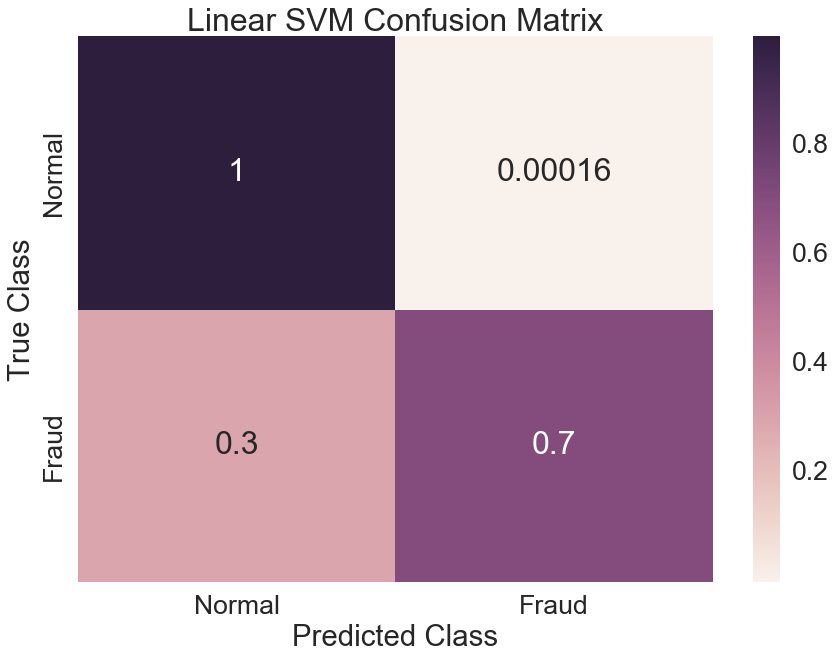

In [44]:
y_preds_svm = svm.predict(X_test)
#print('---Classification Report---')
#print(classification_report(y_test,y_preds_svm))

precision_scores = precision_score(y_test,y_preds_svm,average=None)
recall_scores = recall_score(y_test,y_preds_svm,average=None)

print('---Normal---')
print('Precision: {:.2f} Recall: {:.2f}'.format(precision_scores[0],recall_scores[0]))
print('---Fraud---')
print('Precision: {:.2f} Recall: {:.2f}'.format(precision_scores[1],recall_scores[1]))

#plot confusion matrix
plot_confusion_matrix(y_test,y_preds_svm,labels=np.unique(y_test),title='Linear SVM Confusion Matrix')

From the classification report, the scores of interest are the precision and recall. These measures are more informative for heavily imbalanced classes, such as this dataset.

With default linear SVM without, regularization penalty and cross-validation, we can observe 100% precision and recall for normal transactions, indicating accurate performance on normal transactions. Not bad huh?

For fradulent transactions, the recall score and true positive rate is 0.7, which indicates that the classifier correctly identifies and labels 70% of fraudulent transactions. This also means that the classifier labels 30% of fraudulent transactions (false negative) as normal, in other words 1 in 3 fraud transactions is classified as normal. This is very high!! We need to increase our fraud recall score as close to 1 as possible. 


#### Linear SVM with sample_weight
The SVM classifier (and all other classifiers) in scikit learn have a parameter called 'class_weight' which by default assumes that the classes are balanced i.e. have equal number of labels. However, we know this to not be the case with the current. Let's play around with the 'class_weight' parameter. The class weight parameter allows us to add more weight to one of the classes, in this case the fraud class.

In [45]:
for cw in [1,5,10,100,500,1000]:
    svm = LinearSVC(random_state=RANDOM_SEED,class_weight={0:1, 1:cw})
    svm.fit(X_train,y_train)

    y_preds_svm = svm.predict(X_test)    
    precision_scores = precision_score(y_test,y_preds_svm,average=None)
    recall_scores = recall_score(y_test,y_preds_svm,average=None)
        
    print('-------- Fraud Class Weight: {} --------'.format(cw))
    print('---Normal---')
    print('Precision: {:.2f} Recall: {:.2f}'.format(precision_scores[0],recall_scores[0]))
    print('---Fraud---')
    print('Precision: {:.2f} Recall: {:.2f}'.format(precision_scores[1],recall_scores[1]))
    
    

-------- Fraud Class Weight: 1 --------
---Normal---
Precision: 1.00 Recall: 1.00
---Fraud---
Precision: 0.88 Recall: 0.70
-------- Fraud Class Weight: 5 --------
---Normal---
Precision: 1.00 Recall: 1.00
---Fraud---
Precision: 0.82 Recall: 0.73
-------- Fraud Class Weight: 10 --------
---Normal---
Precision: 1.00 Recall: 1.00
---Fraud---
Precision: 0.88 Recall: 0.62
-------- Fraud Class Weight: 100 --------
---Normal---
Precision: 1.00 Recall: 1.00
---Fraud---
Precision: 0.88 Recall: 0.60
-------- Fraud Class Weight: 500 --------
---Normal---
Precision: 1.00 Recall: 1.00
---Fraud---
Precision: 0.77 Recall: 0.77
-------- Fraud Class Weight: 1000 --------
---Normal---
Precision: 1.00 Recall: 1.00
---Fraud---
Precision: 0.75 Recall: 0.76


Changing the class_weight parameter did increase our recall score in most cases, also the precision score decreases with increasing class_weight. Let's consider anomaly detection algorithms. 

## 3b. Anomaly Detection Algorithm - One Class SVM
In the dataset, fraudulent transactions are rare (0.17%) and in some cases we can think of fraud detection as anomaly or outlier detection problem. Let's see if a One class SVM, an unsupervised novelty detection algorithm, can improve fraud transaction detection. 

In [46]:
X_train,X_test,y_train,y_test = get_training_test_set(data,remove_class=False,convert_labels=True)
contamination = len(data[data['Class']==1])/len(data).__float__()
# nu = proportion of outliers we expect in our data
oneSVM_model = OneClassSVM(kernel='rbf',nu=contamination,gamma=0.00005,random_state=RANDOM_SEED)
oneSVM_model.fit(X_train)

Training set: (227845, 29)
Test set: (56962, 29)


OneClassSVM(cache_size=200, coef0=0.0, degree=3, gamma=5e-05, kernel='rbf',
      max_iter=-1, nu=0.00172748563062, random_state=42, shrinking=True,
      tol=0.001, verbose=False)

-------------Test set-----------
---Normal---
Precision: 1.00 Recall: 1.00
---Fraud---
Precision: 0.28 Recall: 0.26


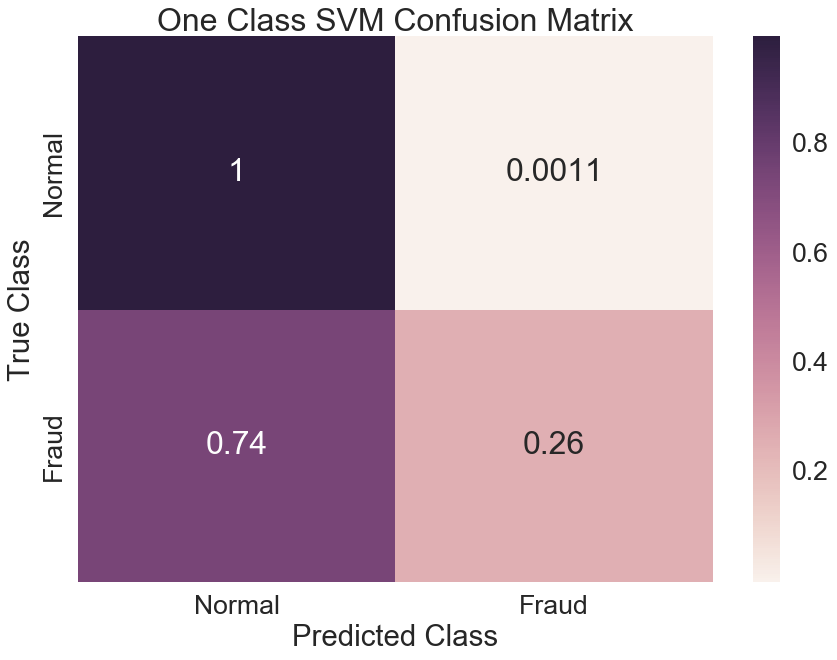

In [47]:
y_pred_ocsvm = oneSVM_model.predict(X_test)
labels=np.unique(y_pred_ocsvm)

precision_scores = precision_score(y_test,y_pred_ocsvm,average=None,labels=labels)
recall_scores = recall_score(y_test,y_pred_ocsvm,average=None,labels=labels)

print('-------------Test set-----------')
print('---Normal---')
print('Precision: {:.2f} Recall: {:.2f}'.format(precision_scores[1],recall_scores[1]))
print('---Fraud---')
print('Precision: {:.2f} Recall: {:.2f}'.format(precision_scores[0],recall_scores[0]))

plot_confusion_matrix(y_test,y_pred_ocsvm,labels=[1,-1],title='One Class SVM Confusion Matrix')

The performance of the OneClassSVM model is underwhelming, as we can see from the precision/recall scores and the confusion matrix. For example, 70% of fraud transactions are classified as normal, which is BAD! We certainly don't want that in a fraud detection model. 

Note, I randomly picked parameter values for the classifier. Next, I will use gridsearchcv to to find parameters that will optimize the performance. With more computing resources, I could use a randomsearchcv instead to explore additional parameters of the model. For now, I use gridsearch to find a suitable 'gamma' value.

In [48]:
best_gamma = 0.10000000000000001 #obtained from grid search with refit='recall_macro'

# nu = proportion of outliers we expect in our data
oneSVM_model = OneClassSVM(kernel='rbf',nu=contamination,gamma=best_gamma,random_state=RANDOM_SEED)
oneSVM_model.fit(X_train)

OneClassSVM(cache_size=200, coef0=0.0, degree=3, gamma=0.1, kernel='rbf',
      max_iter=-1, nu=0.00172748563062, random_state=42, shrinking=True,
      tol=0.001, verbose=False)

-------------Test set-----------
---Normal---
Precision: 1.00 Recall: 0.96
---Fraud---
Precision: 0.03 Recall: 0.80


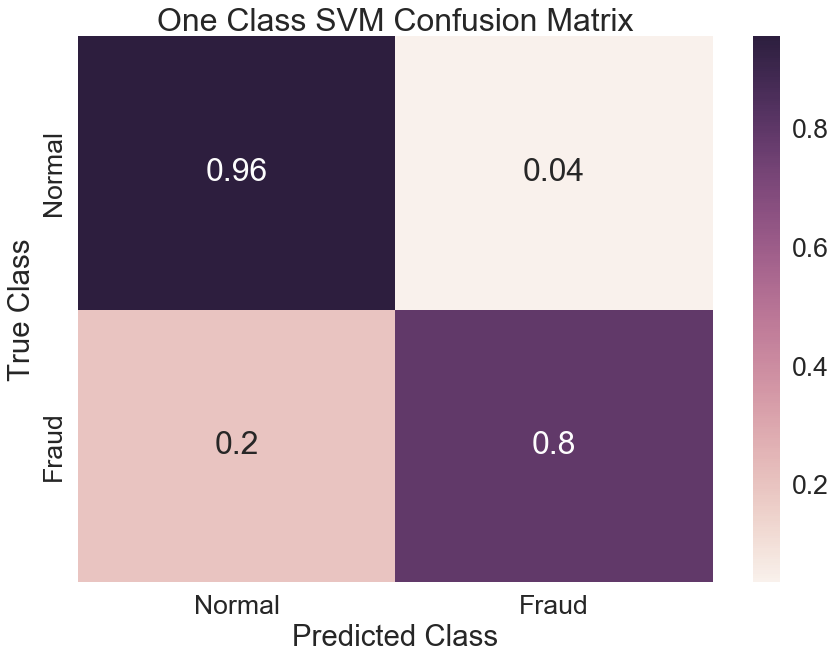

In [49]:
y_pred_ocsvm = oneSVM_model.predict(X_test)
labels=np.unique(y_pred_ocsvm)

precision_scores = precision_score(y_test,y_pred_ocsvm,average=None,labels=labels)
recall_scores = recall_score(y_test,y_pred_ocsvm,average=None,labels=labels)

print('-------------Test set-----------')
print('---Normal---')
print('Precision: {:.2f} Recall: {:.2f}'.format(precision_scores[1],recall_scores[1]))
print('---Fraud---')
print('Precision: {:.2f} Recall: {:.2f}'.format(precision_scores[0],recall_scores[0]))

plot_confusion_matrix(y_test,y_pred_ocsvm,labels=[1,-1],title='One Class SVM Confusion Matrix')

By updating the gamma value, we already get much better performance with the one class svm! Notice, the recall score (and true positive rate) is now 80% for fraud transaction indicating that the model correctly labeled 80% of fraud transactions. The model still however has a high false negative rate of 20%, i.e. 1 in 5 fraud transactions are labeled as normal. Let's see if we lower the false negative rate, i.e. increase our recall score for fraud transactions. 

## 3c. Neural network - Autoencoder
Here I will use a neural network architecture called an autoencoder. An autoencoder is an unsupervised learning method that can be used to learn a low dimensional representation of data. Recently, autoencoders and it's variants have been used to generate images, speech, and text. Here I will use an autoencoder to learn the distribution of features from the normal transaction such that a trained autoencoder can accurately reconstruct the features of normal transactions. However, when the trained autoencoder model is given features from fraud transactions the autoencoder's reconstruction will not be less accurate, given that it has not seen/learned the distribution for fraudulent activity. I will then set a threshold on the reconstruction error, which will distinguish normal vs. fraud transactions. 

In [50]:
#Create training, validation, & test set
X_train,X_rest = train_test_split(data,test_size=0.3, random_state=RANDOM_SEED)
X_train = X_train[X_train['Class']==0]
y_train = X_train.Class
X_train = X_train.drop(['Class'],axis=1)

#From 'rest' set, split into test and validation set
X_valid,X_test = train_test_split(X_rest,test_size=0.1, random_state=RANDOM_SEED)
y_test = X_test.Class
y_valid = X_valid.Class
X_valid = X_valid.drop(['Class'],axis=1)
X_test = X_test.drop(['Class'],axis=1)

#convert from dataframe to numpy array
X_train = X_train.values.astype('float32')
X_valid = X_valid.values.astype('float32')
X_test = X_test.values.astype('float32')
y_train = y_train.values.astype('int')
y_valid = y_valid.values.astype('int')
y_test = y_test.values.astype('int')

print('Training set: {}'.format(X_train.shape))
print('Validation set: {}'.format(X_valid.shape))
print('Test set: {}'.format(X_test.shape))

Training set: (199008, 29)
Validation set: (76898, 29)
Test set: (8545, 29)


### autoencoder model
The autoencoder model consists of and encoder network with two dense layers: 16 and 8 units respectively. The decoder network is the reverse of the encoder network. The total network has 1253 parameters. 

In [51]:
input_dim= X_train.shape[1]
input_layer = Input(shape=(input_dim,),name='input',batch_shape=(None,input_dim))
n_units = [16,8]

#encoder
encoder = Dense(units=n_units[0], activation='relu',name='dense_1')(input_layer)
encoder = Dense(units=n_units[1], activation='relu',name='dense_2')(encoder)

#decoder
decoder = Dense(units=n_units[0],activation='relu',name='dense_3')(encoder)
decoder = Dense(units=input_dim,activation='sigmoid',name='dense_4')(decoder)

#autoencoder
autoencoder = Model(input_layer,decoder,name='autoencoder')

autoencoder.summary()

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input (InputLayer)           (None, 29)                0         
_________________________________________________________________
dense_1 (Dense)              (None, 16)                480       
_________________________________________________________________
dense_2 (Dense)              (None, 8)                 136       
_________________________________________________________________
dense_3 (Dense)              (None, 16)                144       
_________________________________________________________________
dense_4 (Dense)              (None, 29)                493       
Total params: 1,253
Trainable params: 1,253
Non-trainable params: 0
_________________________________________________________________


In [ ]:
#let's compile, train and fit the autoencoder
nb_epoch = 50
batch_size = 64

#use mean_squared_error as the loss function
autoencoder.compile(optimizer='adam',loss='mean_squared_error',metrics=['accuracy'])

checkpoint_file = os.path.join(PATH,'model.h5')
checkpointer = ModelCheckpoint(filepath=checkpoint_file,verbose=1,save_best_only=True)
fitted_autoencoder = autoencoder.fit(X_train,X_train, batch_size=batch_size, epochs=nb_epoch,
                                     validation_data=(X_valid,X_valid),callbacks=[checkpointer],shuffle=True)

In [53]:
#load the trained model. 
autoencoder =  load_model(checkpoint_file)

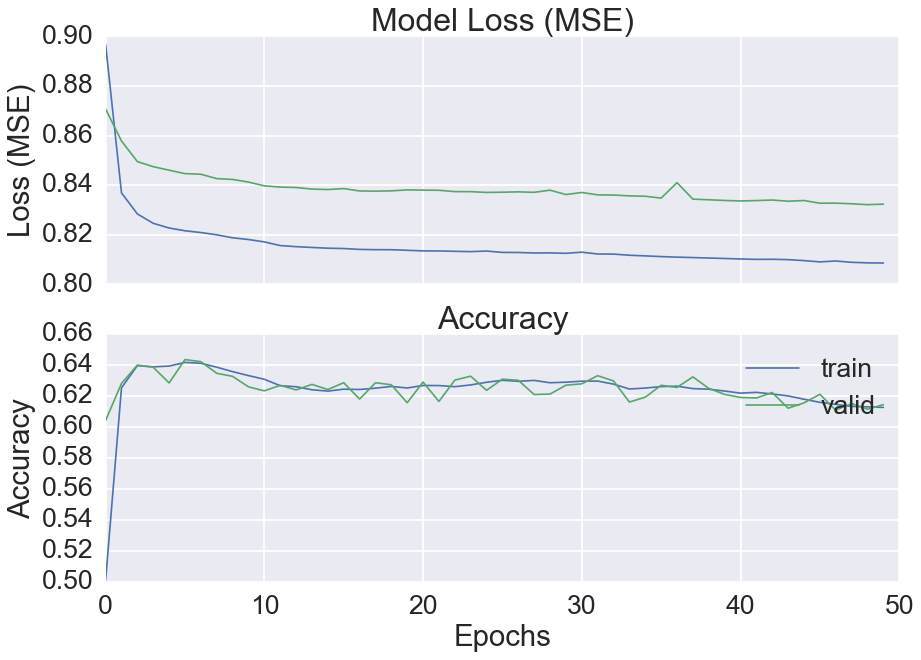

In [78]:
history = fitted_autoencoder.history
#plot model performance
f,(ax1,ax2) = plt.subplots(2,1,sharex=True,sharey=False)
ax1.plot(history['loss'])
ax1.plot(history['val_loss'])
ax1.set_title('Model Loss (MSE)')
ax1.set_ylabel('Loss (MSE)')
#ax1.set_ylim(0,1)

ax2.plot(history['acc'])
ax2.plot(history['val_acc'])
ax2.set_title('Accuracy')
ax2.set_xlabel('Epochs')
ax2.set_ylabel('Accuracy')
ax2.legend(['train','valid'])

####  Distribition of reconstruction errors 
Let's take a look at the distribution of reconstruction errors. 

In [55]:
def calc_mse(ground_truth,predictions):
    mse = np.mean(np.power(ground_truth - predictions,2),axis=1)
    return mse

In [56]:
predictions = autoencoder.predict(X_test)
mse = calc_mse(X_test, predictions)
df_error = pd.DataFrame({'reconstruction_error': mse, 'true_class': y_test})

In [57]:
df_error_normal = df_error[(df_error['true_class']==0)]
df_error_fraud = df_error[(df_error['true_class']==1)]

print('Normal Transactions:')
display(df_error_normal.drop(['true_class'],axis=1).describe())
print('')
print('Fraud Transactions:')
display(df_error_fraud.drop(['true_class'],axis=1).describe())


Normal Transactions:


,reconstruction_error
count,8536.000000
mean,0.744058
std,2.835758
min,0.040786
25%,0.253375
50%,0.421881
75%,0.684761
max,150.882965



Fraud Transactions:


,reconstruction_error
count,9.000000
mean,19.241068
std,23.127672
min,4.549485
25%,6.141943
50%,7.632457
75%,16.154791
max,64.162788


Comparing the summary statistics of the reconstruction error for normal and fraud transactions, we notice that mean and standard deviation of reconstruction errors is much higher for fraud than normal transaction, consistent with the idea that the autoencoder does a much better job reconstructing features of normal transactions than fraud. Let's visualize this further with a histogram of the errors for normal and fraud transactions.  

In [60]:
normal_recon_errors = df_error_normal.reconstruction_error.values
fraud_recon_errors = df_error_fraud.reconstruction_error.values
hist_data = [normal_recon_errors,fraud_recon_errors]
group_labels = ['Normal','Fraud']

fig = ff.create_distplot(hist_data,group_labels,bin_size=2,show_curve=False,show_rug=False,colors=colors)
layout_dict = dict(xaxis=dict(title='Reconstruction Error (MSE)'),
                    title='Autoencoder Reconstruction Error')

fig['layout'].update(layout_dict)

iplot(fig,filename='Autoencoder Reconstruction Error')

### Prediction

Now, let's convert the reconstruction errors into binary predictions. To do so, we'll need to set a threshold on the reconstruction errors. We can use the above histogram distribution plot to guide the selection of the threshold value. 

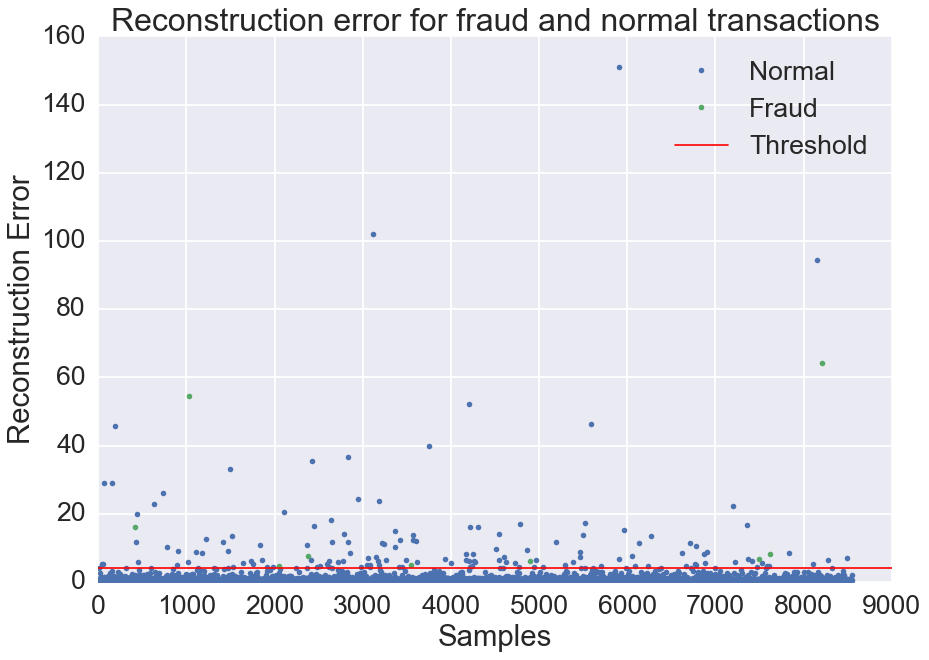

In [84]:
threshold = 4 #threshold on reconstruction error

groups = df_error.groupby(by='true_class')

fig,ax = plt.subplots()
for name,group in groups: 
    ax.plot(group.index,group.reconstruction_error,marker='o',linestyle='',ms=5,label="Fraud" if name==1 else "Normal")
    
ax.hlines(threshold,ax.get_xlim()[0],ax.get_xlim()[1],colors='r',zorder=100, label='Threshold')
ax.legend()
plt.xlabel('Samples')
plt.ylabel('Reconstruction Error')
plt.title('Reconstruction error for fraud and normal transactions')

             precision    recall  f1-score   support

     Normal       1.00      0.98      0.99      8536
      Fraud       0.06      1.00      0.11         9

avg / total       1.00      0.98      0.99      8545



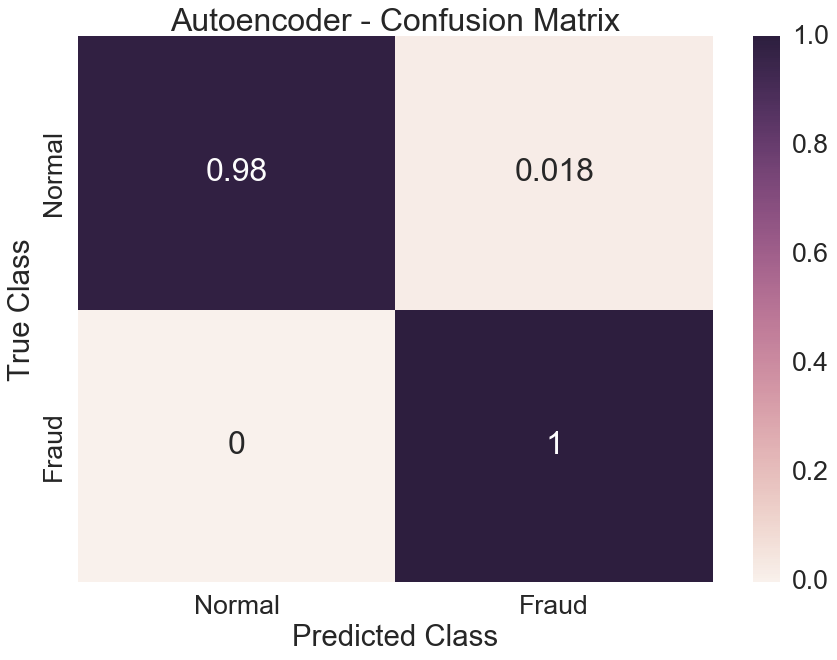

In [85]:
#generate predictions
y_pred = [1 if e > threshold else 0 for e in df_error.reconstruction_error.values]

#plot confusion matrix
conf_matrix = confusion_matrix(df_error.true_class,y_pred)
conf_matrix = conf_matrix.astype('float')/conf_matrix.sum(axis=1)[:,np.newaxis]
plt.figure()
LABELS = ['Normal','Fraud']
sns.heatmap(conf_matrix,xticklabels=LABELS,yticklabels=LABELS,annot=True)
plt.title('Autoencoder - Confusion Matrix')
plt.ylabel('True Class')
plt.xlabel('Predicted Class')

print(classification_report(df_error.true_class,y_pred,target_names=LABELS))

The autoencoder works extremely well for unseen test data! For the threshold value, we observe a recall score of 1 and false positive rate of less than 2%. Depending on the dataset or application, we could dial up/down the threshold to control the fraud detection rate.

## Future Efforts: 
- Evaluate whether autoencoder approach to fraud detection generalizes to other datasets. 
    - Given, that it's based on a neural network, the autoencoder could be extended further to take as input other modalities such as text and images. In other words, the autoencoder could be applied directly to the data of interest to perform feature extraction, without the need to do PCA. 
- Compare autoencoder model to performance of other machine learning classifiers such as logistic regression, random forest, and an anomaly detection algorithm such as isolation forest.
- Balance the data by [oversampling or undersampling the data](https://svds.com/learning-imbalanced-classes/).An example with the dataset was done by [Sandipanweb] (https://sandipanweb.wordpress.com/)

## Inspiration & references
- [scikit-learn User Guide](http://scikit-learn.org/stable/user_guide.html)
- [Credit Card Fraud Detection](https://www.kaggle.com/dalpozz/creditcardfraud)
- [Credit Card Fraud Detection using Autoencoders in Keras — TensorFlow for Hackers](https://medium.com/@curiousily/credit-card-fraud-detection-using-autoencoders-in-keras-tensorflow-for-hackers-part-vii-20e0c85301bd)